In [1]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.cluster import OPTICS
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import silhouette_score
from sklearn.metrics import davies_bouldin_score
import folium

In [2]:
# Import the april dataset
april_s10=pd.read_csv('/Users/ildem/Desktop/Project_week_8/april_10.csv')

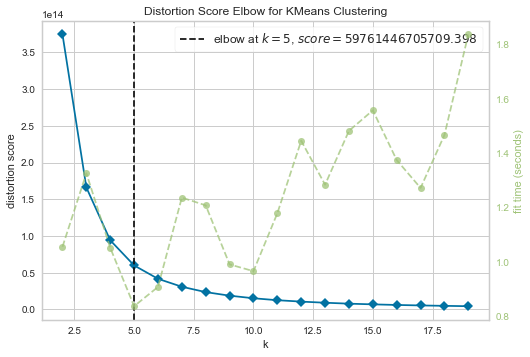

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [3]:
# Elbow Visualizer
model=KMeans()
visualizer = KElbowVisualizer(estimator = model, k = (2,20))
visualizer.fit(april_s10)
visualizer.poof()

In [4]:
# Taking only Lat and Lon columns from the dataset
data_s10=april_s10.iloc[:,1:3]

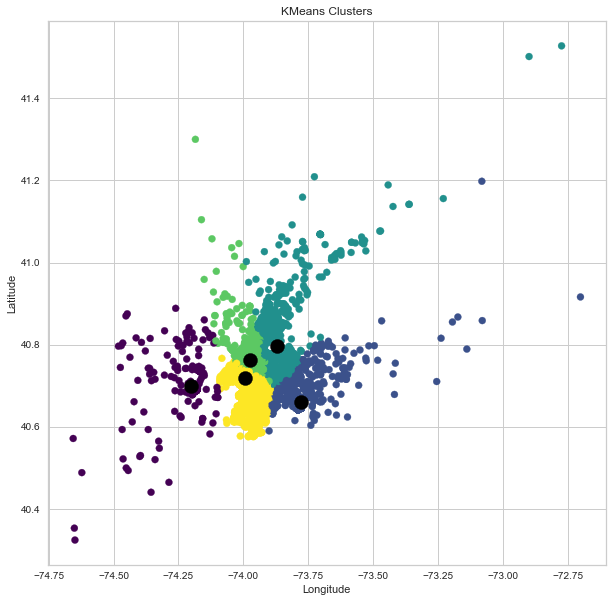

In [14]:
kmeans = KMeans(n_clusters=5).fit(data_s10)
y_kmeans = kmeans.predict(data_s10)
centers=kmeans.cluster_centers_

plt.figure(figsize=(10, 10))
plt.scatter(data_s10.Lon, data_s10.Lat, c=y_kmeans, cmap='viridis_r')
plt.scatter(centers[:, 1], centers[:, 0], c='black', s=200)
plt.title('KMeans Clusters')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()

In [6]:
print('Silhouette score for KMeans is', silhouette_score(data_s10, kmeans.labels_))
print('Davies-Bouldin score for KMeans is', davies_bouldin_score(data_s10, kmeans.labels_))

Silhouette score for KMeans is 0.4349867053458373
Davies-Bouldin score for KMeans is 0.6722536301932592


In [7]:
# Get the kmeans cluster centers into a list
centers=kmeans.cluster_centers_
list_centers=centers.tolist()

In [8]:
# Create a new data frame with Lat and Lon and kmeans labels
kmeans_df=data_s10
kmeans_df['labels']=kmeans.labels_

In [9]:
# Assign the kmeans labels valuses to clusters and split the data accordingly
cluster1 = kmeans_df[['Lat','Lon']][kmeans_df['labels']==0].values.tolist()
cluster2 = kmeans_df[['Lat','Lon']][kmeans_df['labels']==1].values.tolist()
cluster3 = kmeans_df[['Lat','Lon']][kmeans_df['labels']==2].values.tolist()
cluster4 = kmeans_df[['Lat','Lon']][kmeans_df['labels']==3].values.tolist()
cluster5 = kmeans_df[['Lat','Lon']][kmeans_df['labels']==4].values.tolist()

In [15]:
# Generate the map with all points in the sample data and the cluster centers
kmap= folium.Map(location=[40.74, -73.97], zoom_start=10, tiles='Stamen Toner', prefer_canvas=True)


for i in range(0, len(cluster1)):
    folium.CircleMarker(cluster1[i], radius=1 ,color='yellow').add_to(kmap)

for i in range(0, len(cluster2)):
    folium.CircleMarker(cluster2[i], radius=1 ,color='darkblue').add_to(kmap)

for i in range(0, len(cluster3)):
    folium.CircleMarker(cluster3[i], radius=1 ,color='lightgreen').add_to(kmap)

for i in range(0, len(cluster4)):
    folium.CircleMarker(cluster4[i], radius=1 ,color='cadetblue').add_to(kmap)

for i in range(0, len(cluster5)):
    folium.CircleMarker(cluster5[i], radius=1 ,color='purple').add_to(kmap)

for i in list_centers:
    folium.Circle(radius=500, location=i, color="black").add_to(kmap)
kmap